<a href="https://colab.research.google.com/github/Adriana-Sousa/machine-learning/blob/main/rede_de_deteccao/yolo_deteccao.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 35.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 116.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 93.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 55.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 108.8 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstallin

In [15]:
!yolo detect train data=coco128.yaml model=yolo11n.pt epochs=1 imgsz=640

Ultralytics 8.3.169 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=coco128.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=1, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train2, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=12.0, pretrained=True, profile=F

In [2]:
!wget http://images.cocodataset.org/zips/train2017.zip -O /content/train2017.zip
!wget http://images.cocodataset.org/annotations/annotations_trainval2017.zip -O /content/annotations.zip
!mkdir -p /datasets/coco128/images/train /datasets/coco128/labels/train
!unzip /content/train2017.zip -d /datasets/coco128/images/train
!unzip /content/annotations.zip -d /datasets/coco128/

A saída de streaming foi truncada nas últimas 5000 linhas.
 extracting: /datasets/coco128/images/train/train2017/000000563584.jpg  
 extracting: /datasets/coco128/images/train/train2017/000000276069.jpg  
 extracting: /datasets/coco128/images/train/train2017/000000401194.jpg  
 extracting: /datasets/coco128/images/train/train2017/000000502089.jpg  
 extracting: /datasets/coco128/images/train/train2017/000000192183.jpg  
 extracting: /datasets/coco128/images/train/train2017/000000425127.jpg  
 extracting: /datasets/coco128/images/train/train2017/000000126766.jpg  
 extracting: /datasets/coco128/images/train/train2017/000000324161.jpg  
 extracting: /datasets/coco128/images/train/train2017/000000452746.jpg  
 extracting: /datasets/coco128/images/train/train2017/000000423782.jpg  
 extracting: /datasets/coco128/images/train/train2017/000000546343.jpg  
 extracting: /datasets/coco128/images/train/train2017/000000249290.jpg  
 extracting: /datasets/coco128/images/train/train2017/00000002552

In [10]:
import json
import os
from pathlib import Path

def convert_coco_to_yolo(coco_json, image_dir, output_dir, class_names):
    with open(coco_json) as f:
        data = json.load(f)
    images = {x['id']: x['file_name'] for x in data['images']}
    os.makedirs(output_dir, exist_ok=True)
    for ann in data['annotations']:
        img_id = ann['image_id']
        img_name = images.get(img_id)
        if not img_name:
            continue
        img_path = os.path.join(image_dir, img_name)
        if not os.path.exists(img_path):
            continue
        with open(os.path.join(output_dir, img_name.replace('.jpg', '.txt')), 'a') as f:
            class_id = ann['category_id'] - 1  # COCO IDs começam em 1
            x, y, w, h = ann['bbox']
            img_w, img_h = 640, 640  # Ajuste conforme necessário
            center_x = (x + w/2) / img_w
            center_y = (y + h/2) / img_h
            width = w / img_w
            height = h / img_h
            f.write(f"{class_id} {center_x} {center_y} {width} {height}\n")

class_names = [
    'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus', 'train', 'truck', 'boat', 'traffic light',
    'fire hydrant', 'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow',
    'elephant', 'bear', 'zebra', 'giraffe', 'backpack', 'umbrella', 'handbag', 'tie', 'suitcase', 'frisbee',
    'skis', 'snowboard', 'sports ball', 'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard',
    'tennis racket', 'bottle', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple',
    'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake', 'chair', 'couch',
    'potted plant', 'bed', 'dining table', 'toilet', 'tv', 'laptop', 'mouse', 'remote', 'keyboard', 'cell phone',
    'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'book', 'clock', 'vase', 'scissors', 'teddy bear',
    'hair drier', 'toothbrush'
]
convert_coco_to_yolo('/datasets/coco128/annotations/instances_train2017.json', '/datasets/coco128/images/train', '/datasets/coco128/labels/train', class_names)

In [16]:
import os
import random
import shutil

def split_dataset(image_dir, label_dir, train_dir, val_dir, test_dir, train_ratio=0.7, val_ratio=0.2):
    images = [f for f in os.listdir(image_dir) if f.endswith('.jpg')]
    random.shuffle(images)
    total = len(images)
    train_count = int(total * train_ratio)
    val_count = int(total * val_ratio)
    test_count = total - train_count - val_count

    train_images = images[:train_count]
    val_images = images[train_count:train_count + val_count]
    test_images = images[train_count + val_count:]

    os.makedirs(train_dir + '/images', exist_ok=True)
    os.makedirs(train_dir + '/labels', exist_ok=True)
    os.makedirs(val_dir + '/images', exist_ok=True)
    os.makedirs(val_dir + '/labels', exist_ok=True)
    os.makedirs(test_dir + '/images', exist_ok=True)
    os.makedirs(test_dir + '/labels', exist_ok=True)

    for img in train_images:
        shutil.copy(os.path.join(image_dir, img), os.path.join(train_dir, 'images', img))
        label = img.replace('.jpg', '.txt')
        if os.path.exists(os.path.join(label_dir, label)):
            shutil.copy(os.path.join(label_dir, label), os.path.join(train_dir, 'labels', label))

    for img in val_images:
        shutil.copy(os.path.join(image_dir, img), os.path.join(val_dir, 'images', img))
        label = img.replace('.jpg', '.txt')
        if os.path.exists(os.path.join(label_dir, label)):
            shutil.copy(os.path.join(label_dir, label), os.path.join(val_dir, 'labels', label))

    for img in test_images:
        shutil.copy(os.path.join(image_dir, img), os.path.join(test_dir, 'images', img))
        label = img.replace('.jpg', '.txt')
        if os.path.exists(os.path.join(label_dir, label)):
            shutil.copy(os.path.join(label_dir, label), os.path.join(test_dir, 'labels', label))

split_dataset(
    '/content/datasets/coco128/images/train2017',
    '/content/datasets/coco128/labels/train2017',
    '/content/custom_dataset/train',
    '/content/custom_dataset/valid',
    '/content/custom_dataset/test'
)

In [17]:
!ls -l /content/custom_dataset/train/images/
!ls -l /content/custom_dataset/train/labels/
!ls -l /content/custom_dataset/valid/images/
!ls -l /content/custom_dataset/valid/labels/
!ls -l /content/custom_dataset/test/images/
!ls -l /content/custom_dataset/test/labels/

total 4836
-rw-r--r-- 1 root root  62835 Jul 23 21:48 000000000009.jpg
-rw-r--r-- 1 root root  89652 Jul 23 21:48 000000000025.jpg
-rw-r--r-- 1 root root  30089 Jul 23 21:48 000000000030.jpg
-rw-r--r-- 1 root root 105097 Jul 23 21:48 000000000034.jpg
-rw-r--r-- 1 root root  66757 Jul 23 21:48 000000000036.jpg
-rw-r--r-- 1 root root  40899 Jul 23 21:48 000000000049.jpg
-rw-r--r-- 1 root root  59706 Jul 23 21:48 000000000064.jpg
-rw-r--r-- 1 root root  83098 Jul 23 21:48 000000000072.jpg
-rw-r--r-- 1 root root 124117 Jul 23 21:48 000000000073.jpg
-rw-r--r-- 1 root root  47165 Jul 23 21:48 000000000074.jpg
-rw-r--r-- 1 root root  73636 Jul 23 21:48 000000000078.jpg
-rw-r--r-- 1 root root  23700 Jul 23 21:48 000000000081.jpg
-rw-r--r-- 1 root root  41759 Jul 23 21:48 000000000089.jpg
-rw-r--r-- 1 root root  66547 Jul 23 21:48 000000000094.jpg
-rw-r--r-- 1 root root  56509 Jul 23 21:48 000000000110.jpg
-rw-r--r-- 1 root root  55067 Jul 23 21:48 000000000113.jpg
-rw-r--r-- 1 root root  64488

In [18]:
yaml_content = """
path: /content/custom_dataset
train: train/images
val: valid/images
test: test/images
nc: 80
names: [
  'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus', 'train', 'truck', 'boat', 'traffic light',
  'fire hydrant', 'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow',
  'elephant', 'bear', 'zebra', 'giraffe', 'backpack', 'umbrella', 'handbag', 'tie', 'suitcase', 'frisbee',
  'skis', 'snowboard', 'sports ball', 'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard',
  'tennis racket', 'bottle', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple',
  'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake', 'chair', 'couch',
  'potted plant', 'bed', 'dining table', 'toilet', 'tv', 'laptop', 'mouse', 'remote', 'keyboard', 'cell phone',
  'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'book', 'clock', 'vase', 'scissors', 'teddy bear',
  'hair drier', 'toothbrush',
]
"""
with open('/content/custom_dataset/custom_coco.yaml', 'w') as f:
    f.write(yaml_content)

In [19]:
from ultralytics import YOLO
model = YOLO("yolo11n.pt")
model.train(
    data="/content/custom_dataset/custom_coco.yaml",
    epochs=3,
    imgsz=416,
    batch=8,
    device='cpu',
    patience=50,
    pretrained=True,
    freeze=10
)

Ultralytics 8.3.169 🚀 Python-3.11.13 torch-2.6.0+cu124 CPU (Intel Xeon 2.00GHz)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=8, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/custom_dataset/custom_coco.yaml, degrees=0.0, deterministic=True, device=cpu, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=3, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=10, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=416, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train3, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=50, perspective=0.0, plots=True, pose=12.0, pretra

train: Scanning /content/custom_dataset/train/labels... 88 images, 1 backgrounds, 0 corrupt: 100%|██████████| 89/89 [00:00<00:00, 1697.69it/s]

train: New cache created: /content/custom_dataset/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1121.5±636.9 MB/s, size: 55.9 KB)


val: Scanning /content/custom_dataset/valid/labels... 25 images, 0 backgrounds, 0 corrupt: 100%|██████████| 25/25 [00:00<00:00, 2195.01it/s]

val: New cache created: /content/custom_dataset/valid/labels.cache


Plotting labels to runs/detect/train3/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000119, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
Image sizes 416 train, 416 val
Using 0 dataloader workers
Logging results to runs/detect/train3
Starting training for 3 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/3         0G      1.312      1.873      1.254          4        416: 100%|██████████| 12/12 [00:17<00:00,  1.44s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.34s/it]

                   all         25        228      0.706      0.504      0.624       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        2/3         0G      1.263      1.833      1.249         25        416: 100%|██████████| 12/12 [00:15<00:00,  1.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.37s/it]

                   all         25        228      0.698      0.506      0.607       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        3/3         0G      1.297      1.655      1.252         23        416: 100%|██████████| 12/12 [00:16<00:00,  1.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.23s/it]

                   all         25        228      0.695      0.512      0.598      0.454



3 epochs completed in 0.016 hours.
Optimizer stripped from runs/detect/train3/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/train3/weights/best.pt, 5.5MB

Validating runs/detect/train3/weights/best.pt...
Ultralytics 8.3.169 🚀 Python-3.11.13 torch-2.6.0+cu124 CPU (Intel Xeon 2.00GHz)
YOLO11n summary (fused): 100 layers, 2,616,248 parameters, 0 gradients, 6.5 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.01s/it]


                   all         25        228      0.707      0.504      0.624       0.47
                person         14         74      0.814      0.541      0.732      0.462
                   car          3         27          1          0      0.105     0.0566
            motorcycle          2          2      0.778          1      0.995        0.8
              airplane          2          2      0.765          1      0.995      0.895
                   bus          2          3      0.667      0.333      0.342       0.24
                 train          1          1      0.503          1      0.995      0.995
                 truck          3         10      0.829        0.3        0.4      0.245
         traffic light          2         10          1          0     0.0816     0.0238
                 bench          1          2          1      0.637      0.995      0.448
                  bird          1          8          1      0.916      0.995      0.448
                   do

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([ 0,  2,  3,  4,  5,  6,  7,  9, 13, 14, 16, 21, 24, 26, 27, 28, 29, 32, 34, 35, 36, 39, 40, 41, 42, 43, 45, 48, 50, 52, 53, 54, 55, 56, 59, 60, 68, 69, 72, 77])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7ecd86627290>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.0

In [25]:
from google.colab import files
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import requests
from io import BytesIO

def get_image_from_url(url):
    try:
        # Adicionar cabeçalho User-Agent para evitar bloqueios
        headers = {'User-Agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/91.0.4472.124 Safari/537.36'}

        # Baixar a imagem
        response = requests.get(url, headers=headers, timeout=10)

        # Verificar se a requisição foi bem-sucedida
        if response.status_code != 200:
            raise ValueError(f"Erro ao baixar a imagem: Status {response.status_code}")

        # Verificar se o conteúdo é uma imagem válida
        content_type = response.headers.get('content-type', '')
        if 'image' not in content_type:
            raise ValueError(f"URL não aponta para uma imagem válida: {content_type}")

        # Tentar abrir a imagem
        img = Image.open(BytesIO(response.content)).convert('RGB')

    except requests.exceptions.RequestException as e:
        print(f"Erro ao baixar a imagem: {e}")
    except ValueError as e:
        print(f"Erro: {e}")
    except Exception as e:
        print(f"Erro ao processar a imagem: {e}")
    return img

url = "https://images.unsplash.com/photo-1514888286974-6c03e2ca1dba"

img = get_image_from_url(url)
image_array = np.array(img)


0: 448x640 1 cat, 109.0ms
Speed: 4.2ms preprocess, 109.0ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)


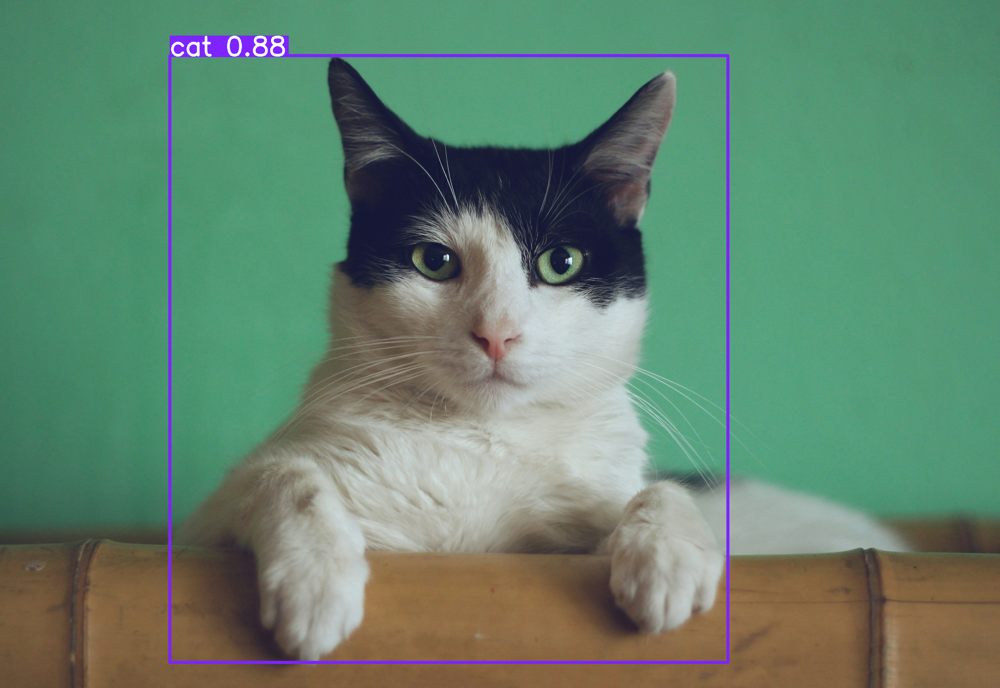

In [26]:
model = YOLO("/content/runs/detect/train/weights/best.pt")
results = model.predict(img, conf=0.5, iou=0.5)
results[0].show()